## Analysis of twisted crystal planes from 2D waxs XRD data

In [1]:
from waxsPlots import datasets as ds
import os, os.path
import shutil
import glob

import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

First we need to specify the filepath that the data is located in

The datasets can then be stored as a list

In [2]:
data_direc = '/Users/Teslagon/Documents/My Documents/xrdata/stw_MeOH_Q1.18overChi/'


isdir = os.path.isdir(f'{data_direc}/plots')
if isdir==False:
    print("directory does not exist")Included in the **datasets** module is a method to sort the data. the *imgOrPlot* function will determine whether the files are images or text files and sort them automatically

In [3]:
read_dir = []
read_dir = ds.ch_dir(read_dir, data_direc)

Directories do not yet exist

Initial files moved to new filepathat:
 /Users/Teslagon/Documents/My Documents/xrdata/stw_MeOH_Q1.18overChi/raw_data


In [4]:
sort_dir = ds.imgOrPlot(read_dir)

The *df_to_dict* method in the datasets module allows us to store the values of each scan as a nested list. The function can be understood as follows:

**ds**.*df_to_dict*( listOfFilenames, ContentsOfFiles, PeakIntensityScans )

*df_to_dict* takes the sorted list of filenames we created above and reads the contents of the files into a dataframe with Pandas' *read_csv* function. The dataframe can be then stored in an empty list.

To do so we first need to create and empty list:

someList = [ ]

We then pass the empty list into the *df_to_dict* function.

This list will generate the peak intensities and the angles for each scan and store them in a nested list of *i* scans with *j* datapoints.

||`Angle`|`Intensity`|
|---|---|---|
|0|Ø<sub>1<sub/>|Int<sub>1<sub/>|
|1|Ø<sub>2<sub/>|Int<sub>2<sub/>|
|2|Ø<sub>3<sub/>|Int<sub>3<sub/>|
|3|...|...|
|n|Ø<sub>n<sub/>|Int<sub>n<sub/>|

In [5]:
dfList = []

ds.df_to_list(sort_dir, dfList)

Once we have created our nested listed, we will want to determine the angles where the intensity is at a maximum. The *getMaxPeak* function goes through the nested list and finds the maximum intensity at each scan and passes them to another empty list. It then matches those intensity to the corresponding angles and passes them to a second newly generated list. 

peakAndAngleIntensity = [ `Angle`, `Max intensity` ] 

We can then plot these values in a heatmap to visualize the 2D waxs scan


In [6]:
angleAtPeak = []

ds.getMaxPeak(dfList, angleAtPeak)

Explaining the heatmap portion

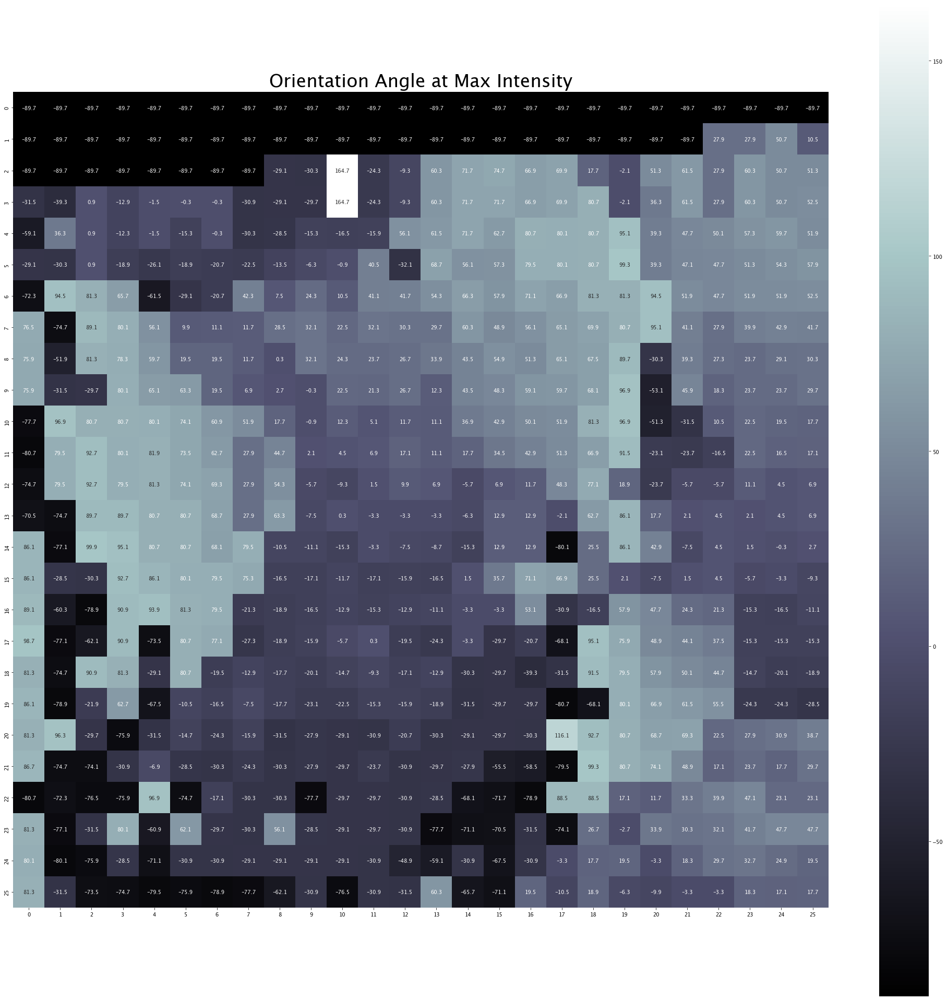

In [7]:
ds.xrd_heatmap(angleAtPeak, savepath=data_direc, IntOrAng = 0, plt_size=35.0, 
               plotTitle='Orientation Angle at Max Intensity', 
               mapColor='bone')

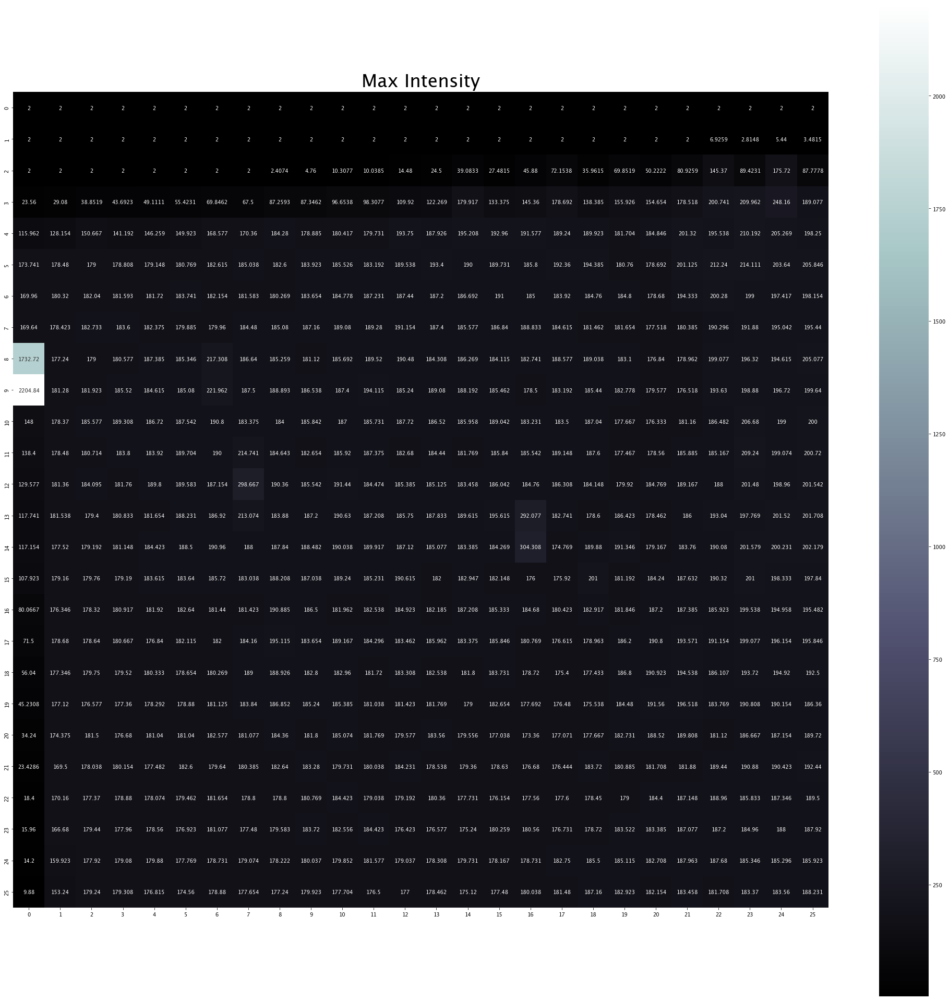

In [8]:
ds.xrd_heatmap(angleAtPeak, savepath=data_direc, IntOrAng = 1, plt_size=35.0,
               plotTitle="Max Intensity", mapColor='bone')

/Users/Teslagon/Documents/My Documents/xrdata/lib/python3.9/site-packages/pandas/plotting/_matplotlib/core.py:386: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


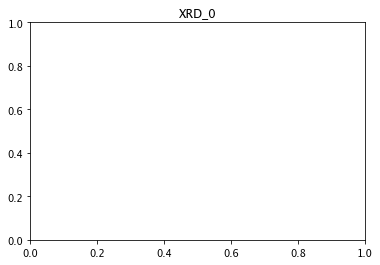

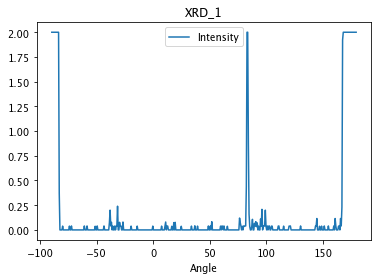

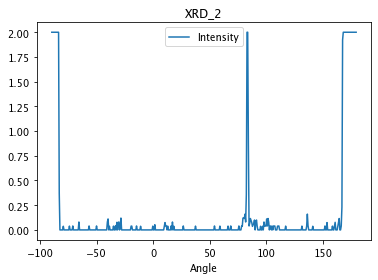

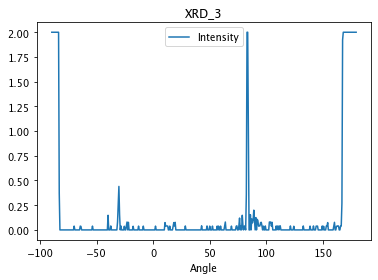

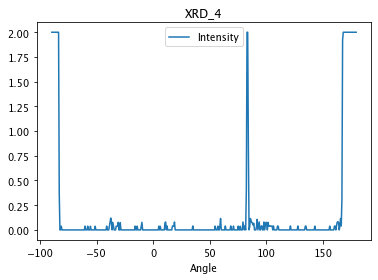

...

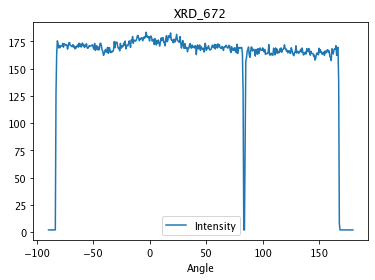

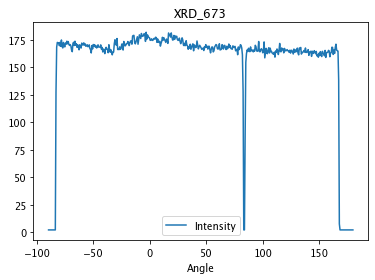

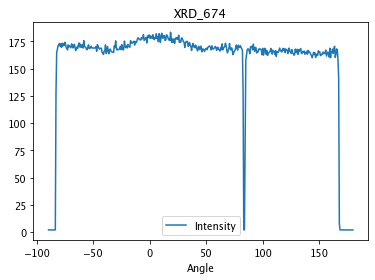

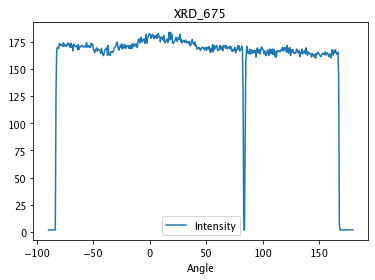

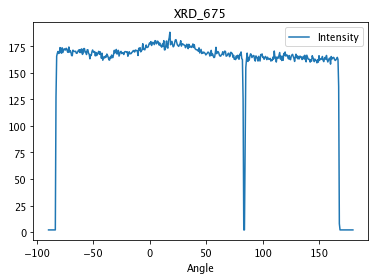

In [9]:
ds.angleVintensity_plots(dfList, dir_name=data_direc)

No serpentine scans. plot order unchanged


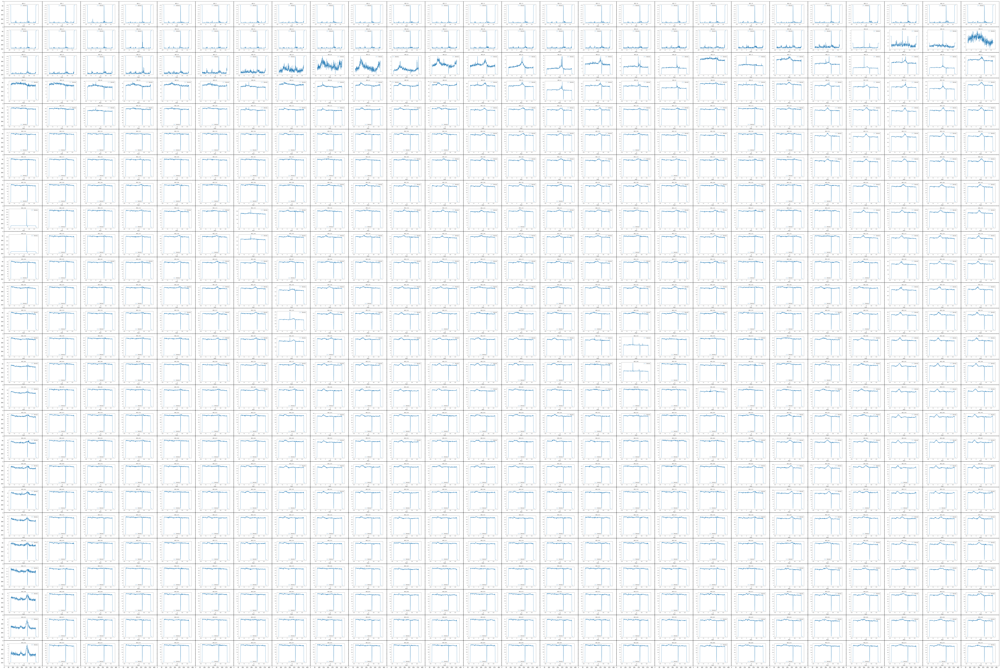

In [10]:
ds.plot_scans(data_direc, serpentine=False)